In [1]:
import pandas as pd
import numpy as np

df = pd.read_csv('../data/BTC_1m.csv')
df

,Datetime,Open,High,Low,Close,Volume,Dividends,Stock Splits,AD,ma15,...,dc,upper2,lower2,macd,macd_signal,hist,rsi14,rsi28,slowK,slowD
0,2024-02-20 00:00:00+00:00,7780113.0,7780113.0,7780113.0,7780113.0,0,0.0,0.0,0.000000e+00,7.781046e+06,...,1,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
1,2024-02-20 00:01:00+00:00,7780712.0,7780712.0,7780712.0,7780712.0,247201792,0.0,0.0,0.000000e+00,7.781046e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2,2024-02-20 00:02:00+00:00,7778306.0,7778306.0,7777378.0,7777378.0,0,0.0,0.0,0.000000e+00,7.781046e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
3,2024-02-20 00:03:00+00:00,7780024.5,7780024.5,7780024.5,7780024.5,0,0.0,0.0,0.000000e+00,7.781046e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
4,2024-02-20 00:04:00+00:00,7781959.5,7781959.5,7781959.5,7781959.5,383778816,0.0,0.0,0.000000e+00,7.781046e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25539,2024-03-11 12:19:00+00:00,10506303.0,10514883.0,10506303.0,10514883.0,0,0.0,0.0,4.479404e+11,1.051001e+07,...,0,1.054985e+07,1.047085e+07,-5691.137102,-6448.412284,757.275182,50.144678,49.310379,53.086063,35.627974
25540,2024-03-11 12:21:00+00:00,10514533.0,10514533.0,10513713.0,10513713.0,9701949440,0.0,0.0,4.382384e+11,1.050992e+07,...,0,1.053755e+07,1.047829e+07,-4854.679869,-6129.665801,1274.985932,49.678140,49.071436,84.773410,52.774667
25541,2024-03-11 12:23:00+00:00,10521962.0,10521962.0,10521962.0,10521962.0,4958191616,0.0,0.0,4.382384e+11,1.050973e+07,...,0,1.052905e+07,1.048394e+07,-3485.972011,-5600.927043,2114.955032,52.998423,50.814074,97.642216,78.500563
25542,2024-03-11 12:24:00+00:00,10530336.0,10530336.0,10530336.0,10530336.0,0,0.0,0.0,4.382384e+11,1.051024e+07,...,0,1.053193e+07,1.048353e+07,-1705.884976,-4821.918630,3116.033654,56.160689,52.524261,98.354014,93.589880


In [2]:
# 不要な列を削除
df = df.drop(columns=['Dividends', 'Stock Splits'])

# 'Datetime'列をdatetime型に変換
df['Datetime'] = pd.to_datetime(df['Datetime'])
df.set_index('Datetime', inplace=True)

df

,Open,High,Low,Close,Volume,AD,ma15,ma30,ma75,gc,dc,upper2,lower2,macd,macd_signal,hist,rsi14,rsi28,slowK,slowD
Datetime,,,,,,,,,,,,,,,,,,,,
2024-02-20 00:00:00+00:00,7780113.0,7780113.0,7780113.0,7780113.0,0,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,1,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:01:00+00:00,7780712.0,7780712.0,7780712.0,7780712.0,247201792,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:02:00+00:00,7778306.0,7778306.0,7777378.0,7777378.0,0,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:03:00+00:00,7780024.5,7780024.5,7780024.5,7780024.5,0,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:04:00+00:00,7781959.5,7781959.5,7781959.5,7781959.5,383778816,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-11 12:19:00+00:00,10506303.0,10514883.0,10506303.0,10514883.0,0,4.479404e+11,1.051001e+07,1.052250e+07,1.051901e+07,0,0,1.054985e+07,1.047085e+07,-5691.137102,-6448.412284,757.275182,50.144678,49.310379,53.086063,35.627974
2024-03-11 12:21:00+00:00,10514533.0,10514533.0,10513713.0,10513713.0,9701949440,4.382384e+11,1.050992e+07,1.052049e+07,1.051912e+07,0,0,1.053755e+07,1.047829e+07,-4854.679869,-6129.665801,1274.985932,49.678140,49.071436,84.773410,52.774667
2024-03-11 12:23:00+00:00,10521962.0,10521962.0,10521962.0,10521962.0,4958191616,4.382384e+11,1.050973e+07,1.051843e+07,1.051952e+07,0,0,1.052905e+07,1.048394e+07,-3485.972011,-5600.927043,2114.955032,52.998423,50.814074,97.642216,78.500563


In [3]:
# 対数収益率
df['return'] = np.log(df['Close'] / df['Close'].shift(1))

# 対数収益率が正の場合（価格が上昇した場合）には１を，そうでない場合は０を割り当てる
df['direction'] = np.where(df['return'] > 0, 1, 0)
df

,Open,High,Low,Close,Volume,AD,ma15,ma30,ma75,gc,...,lower2,macd,macd_signal,hist,rsi14,rsi28,slowK,slowD,return,direction
Datetime,,,,,,,,,,,,,,,,,,,,,
2024-02-20 00:00:00+00:00,7780113.0,7780113.0,7780113.0,7780113.0,0,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,...,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591,NaN,0
2024-02-20 00:01:00+00:00,7780712.0,7780712.0,7780712.0,7780712.0,247201792,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,...,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591,0.000077,1
2024-02-20 00:02:00+00:00,7778306.0,7778306.0,7777378.0,7777378.0,0,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,...,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591,-0.000429,0
2024-02-20 00:03:00+00:00,7780024.5,7780024.5,7780024.5,7780024.5,0,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,...,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591,0.000340,1
2024-02-20 00:04:00+00:00,7781959.5,7781959.5,7781959.5,7781959.5,383778816,0.000000e+00,7.781046e+06,7.780570e+06,7.770193e+06,0,...,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591,0.000249,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-11 12:19:00+00:00,10506303.0,10514883.0,10506303.0,10514883.0,0,4.479404e+11,1.051001e+07,1.052250e+07,1.051901e+07,0,...,1.047085e+07,-5691.137102,-6448.412284,757.275182,50.144678,49.310379,53.086063,35.627974,0.000840,1
2024-03-11 12:21:00+00:00,10514533.0,10514533.0,10513713.0,10513713.0,9701949440,4.382384e+11,1.050992e+07,1.052049e+07,1.051912e+07,0,...,1.047829e+07,-4854.679869,-6129.665801,1274.985932,49.678140,49.071436,84.773410,52.774667,-0.000111,0
2024-03-11 12:23:00+00:00,10521962.0,10521962.0,10521962.0,10521962.0,4958191616,4.382384e+11,1.050973e+07,1.051843e+07,1.051952e+07,0,...,1.048394e+07,-3485.972011,-5600.927043,2114.955032,52.998423,50.814074,97.642216,78.500563,0.000784,1


In [4]:
lags = 5

cols = []
for lag in range(1, lags + 1):
    col = f'lag_{lag}'
    df[col] = df['return'].shift(lag)
    cols.append(col)
df.dropna(inplace=True)
df.round(4).tail()

,Open,High,Low,Close,Volume,AD,ma15,ma30,ma75,gc,...,rsi28,slowK,slowD,return,direction,lag_1,lag_2,lag_3,lag_4,lag_5
Datetime,,,,,,,,,,,,,,,,,,,,,
2024-03-11 12:19:00+00:00,10506303.0,10514883.0,10506303.0,10514883.0,0,4.479404e+11,1.051001e+07,1.052250e+07,1.051901e+07,0,...,49.3104,53.0861,35.6280,0.0008,1,0.0014,-0.0012,-0.0011,0.0008,-0.0006
2024-03-11 12:21:00+00:00,10514533.0,10514533.0,10513713.0,10513713.0,9701949440,4.382384e+11,1.050992e+07,1.052049e+07,1.051912e+07,0,...,49.0714,84.7734,52.7747,-0.0001,0,0.0008,0.0014,-0.0012,-0.0011,0.0008
2024-03-11 12:23:00+00:00,10521962.0,10521962.0,10521962.0,10521962.0,4958191616,4.382384e+11,1.050973e+07,1.051843e+07,1.051952e+07,0,...,50.8141,97.6422,78.5006,0.0008,1,-0.0001,0.0008,0.0014,-0.0012,-0.0011
2024-03-11 12:24:00+00:00,10530336.0,10530336.0,10530336.0,10530336.0,0,4.382384e+11,1.051024e+07,1.051645e+07,1.052010e+07,0,...,52.5243,98.3540,93.5899,0.0008,1,0.0008,-0.0001,0.0008,0.0014,-0.0012
2024-03-11 12:25:00+00:00,10530609.0,10530609.0,10530609.0,10530609.0,0,4.382384e+11,1.051109e+07,1.051447e+07,1.052073e+07,0,...,52.5800,100.0000,98.6654,0.0000,1,0.0008,0.0008,-0.0001,0.0008,0.0014


In [5]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import numpy as np

# 特徴量とターゲットの分離
X = df.drop('Close', axis=1).values
y = df['Close'].values

In [6]:
# 訓練データとテストデータの分割
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 訓練データとテストデータの形状を表示（確認用）
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((20430, 26), (5108, 26), (20430,), (5108,))

In [23]:
# ガウス標準化(Zスコア正規化)によって特徴量データを標準化
mu, std = X_train.mean(), X_train.std()
X_train = (X_train - mu) / std
X_test = (X_test - mu) / std
y_train = (y_train - mu) / std
y_test = (X_test - mu) / std
y_test

array([[0.02137608, 0.02137608, 0.02137608, ..., 0.02132509, 0.02132509,
        0.02132509],
       [0.02139154, 0.02139154, 0.02139154, ..., 0.02132509, 0.02132509,
        0.02132509],
       [0.02137654, 0.02137654, 0.02137654, ..., 0.02132509, 0.02132509,
        0.02132509],
       ...,
       [0.02137691, 0.02137691, 0.02137691, ..., 0.02132509, 0.02132509,
        0.02132509],
       [0.02137634, 0.02137634, 0.02137634, ..., 0.02132509, 0.02132509,
        0.02132509],
       [0.02137616, 0.02137619, 0.02137616, ..., 0.02132509, 0.02132509,
        0.02132509]])

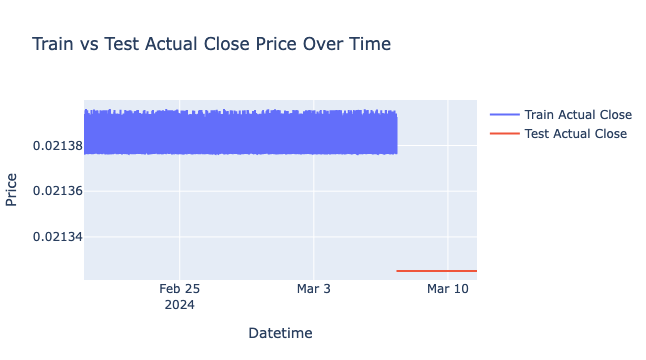

In [8]:
import plotly.graph_objects as go

# トレーニングデータセットとテストデータセットに対応する日付
train_dates = df.index[:len(y_train)]
test_dates = df.index[len(y_train):len(y_train) + len(y_test)]

# Plotlyでのグラフ作成
fig = go.Figure()

# トレーニングデータセットの実際の終値のプロット
fig.add_trace(go.Scatter(x=train_dates, y=y_train.flatten(), mode='lines', name='Train Actual Close'))

# テストデータセットの実際の終値のプロット
fig.add_trace(go.Scatter(x=test_dates, y=y_test.flatten(), mode='lines', name='Test Actual Close'))

# タイトルと軸のラベル設定
fig.update_layout(title='Train vs Test Actual Close Price Over Time', xaxis_title='Datetime', yaxis_title='Price')

# グラフの表示
fig.show()

In [9]:
def create_sequences(X, y, time_steps=60):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

# シーケンスの作成
X_train_seq, y_train_seq = create_sequences(X_train, y_train)
X_test_seq, y_test_seq = create_sequences(X_test, y_test)

# シーケンス化されたデータの形状を表示（確認用）
X_train_seq.shape, X_test_seq.shape, y_train_seq.shape, y_test_seq.shape


((20370, 60, 26), (5048, 60, 26), (20370,), (5048, 26))

In [10]:
import keras_tuner as kt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam

def build_model(hp):
    model = Sequential([
        LSTM(
            units=hp.Int('units', min_value=32, max_value=512, step=32),
            return_sequences=True,
            input_shape=(X_train_seq.shape[1], X_train_seq.shape[2])
        ),
        Dropout(0.2),
        LSTM(units=hp.Int('units', min_value=32, max_value=512, step=32), return_sequences=False),
        Dropout(0.2),
        Dense(1)
    ])
    
    model.compile(
        optimizer=Adam(
            learning_rate=hp.Choice('learning_rate', values=[1e-4, 1e-3, 1e-2])
        ),
        loss='mse'
    )
    
    return model

# GridSearchチューナーのインスタンス化
tuner = kt.GridSearch(
    build_model,
    objective='val_loss',
    max_trials=5,  # ハイパーパラメータの組み合わせの最大試行回数
    directory='my_dir',  # 調整の結果を保存するディレクトリ
    project_name='lstm_hyperparam_tuning'
)

tuner.search(
    X_train_seq, y_train_seq,
    epochs=10,
    validation_split=0.2,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)]
)

# 最適なハイパーパラメータの取得
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
The hyperparameter search is complete. The optimal number of units in the LSTM layers
is {best_hps.get('units')} and the optimal learning rate for the optimizer
is {best_hps.get('learning_rate')}.
""")


Trial 5 Complete [00h 03m 05s]
val_loss: 5.740250941244085e-08

Best val_loss So Far: 6.682037145822051e-09
Total elapsed time: 00h 20m 00s

The hyperparameter search is complete. The optimal number of units in the LSTM layers
is 32 and the optimal learning rate for the optimizer
is 0.01.



In [15]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
from tensorflow.keras.optimizers import Adam

# 最適なハイパーパラメータの値
optimal_units = best_hps.get('units')  # 例: ハイパーパラメータ調整で見つかった最適なunits
optimal_learning_rate = best_hps.get('learning_rate')  # 例: ハイパーパラメータ調整で見つかった最適なlearning_rate

# モデルの定義（最適なハイパーパラメータを使用）
model = Sequential([
    LSTM(optimal_units, return_sequences=True, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2])),
    Dropout(0.2),
    LSTM(optimal_units, return_sequences=False),
    Dropout(0.2),
    Dense(1)
])

# コンパイル（最適な学習率を使用）
model.compile(optimizer=Adam(learning_rate=optimal_learning_rate), loss='mse')

# モデルの要約を表示
model.summary()

# モデルの訓練
history = model.fit(X_train_seq, y_train_seq, epochs=10, batch_size=32, validation_split=0.1, verbose=1)


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 60, 32)            7552      
                                                                 
 dropout_4 (Dropout)         (None, 60, 32)            0         
                                                                 
 lstm_5 (LSTM)               (None, 32)                8320      
                                                                 
 dropout_5 (Dropout)         (None, 32)                0         
                                                                 
 dense_2 (Dense)             (None, 1)                 33        
                                                                 
Total params: 15905 (62.13 KB)
Trainable params: 15905 (62.13 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/10
573/573

In [16]:
from tensorflow.keras.metrics import MeanAbsoluteError, MeanSquaredError
import numpy as np

# モデルを使用してテストデータセット上で予測
predictions = model.predict(X_test_seq)

# MAEとMSEの計算
mae = MeanAbsoluteError()
mse = MeanSquaredError()

mae.update_state(y_test_seq, predictions)
mse.update_state(y_test_seq, predictions)

print(f"Mean Absolute Error (MAE): {mae.result().numpy()}")
print(f"Mean Squared Error (MSE): {mse.result().numpy()}")


158/158 [==============================] - 3s 15ms/step
Mean Absolute Error (MAE): 0.00016357282584067434
Mean Squared Error (MSE): 2.812758914672031e-08


In [17]:
predictions

array([[0.0211562 ],
       [0.02108767],
       [0.02111618],
       ...,
       [0.02123395],
       [0.02126384],
       [0.02127946]], dtype=float32)

In [19]:
# 予測値を元のスケールに戻すために2次元配列に変換
# predictions = predictions * std + mu

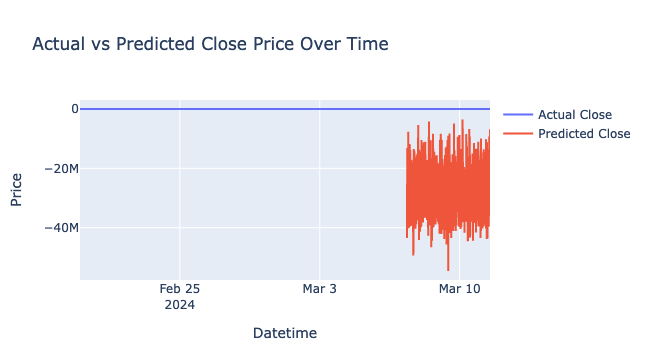

In [25]:
import plotly.graph_objects as go

# テストデータセットの日付データ（ここでは、テストデータセットのDatetimeカラムを使用すると仮定）
test_dates = df.index[-len(predictions):]  # テストデータセットに対応する日付

# Plotlyでのグラフ作成
fig = go.Figure()

# 実際の終値のプロット
fig.add_trace(go.Scatter(x=df.index, y=X_train.flatten(), mode='lines', name='Actual Close'))

# 予測値のプロット
fig.add_trace(go.Scatter(x=test_dates, y=predictions.flatten(), mode='lines', name='Predicted Close'))

# タイトルと軸のラベル設定
fig.update_layout(title='Actual vs Predicted Close Price Over Time', xaxis_title='Datetime', yaxis_title='Price')

# グラフの表示
fig.show()